In [ ]:
from google.colab import drive
drive.mount("/drive")

Mounted at /drive


In [ ]:
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import cv2
import math
from google.colab.patches import cv2_imshow

In [ ]:
file_name = 'TOFD3.xlsx'
sheet = '20_08_2021_170PCS_60deg-S_C_BPP'
df = pd.read_excel(io=file_name, sheet_name=sheet)
df = df[df.iloc[:,1] != '---']
df = df.astype(float)
#print(df.head(5)) 
im_arr = df.to_numpy()

In [ ]:
im_arr = df.to_numpy()

In [ ]:
im_arr = cv2.normalize(im_arr, None, alpha = 0, beta = 255, norm_type = cv2.NORM_MINMAX, dtype = cv2.CV_32F)
im_arr = im_arr.astype(np.uint8)
#cv2_imshow(im_arr)
#para = im_arr

#[500:800, 500:800]
#[800:1100, 1000:1300]
#[800:1100, 500:800]
#[1100:1400, 500:800]

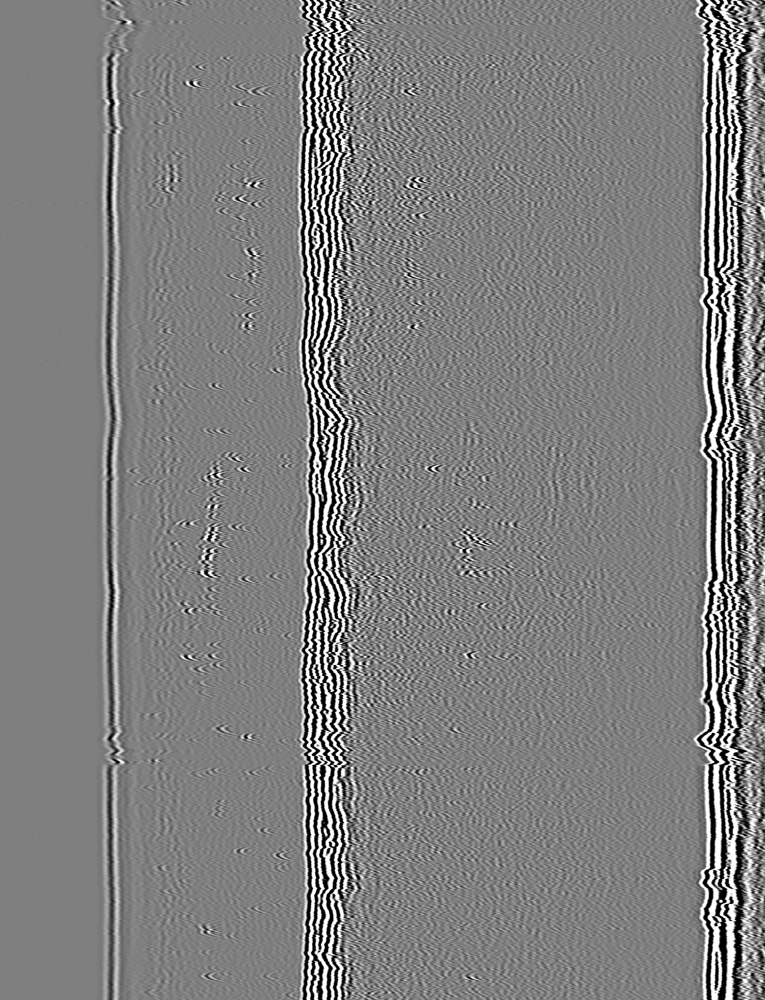

In [ ]:
cv2_imshow(im_arr)

In [ ]:
img = cv2.Canny(im_arr, 400, 500)

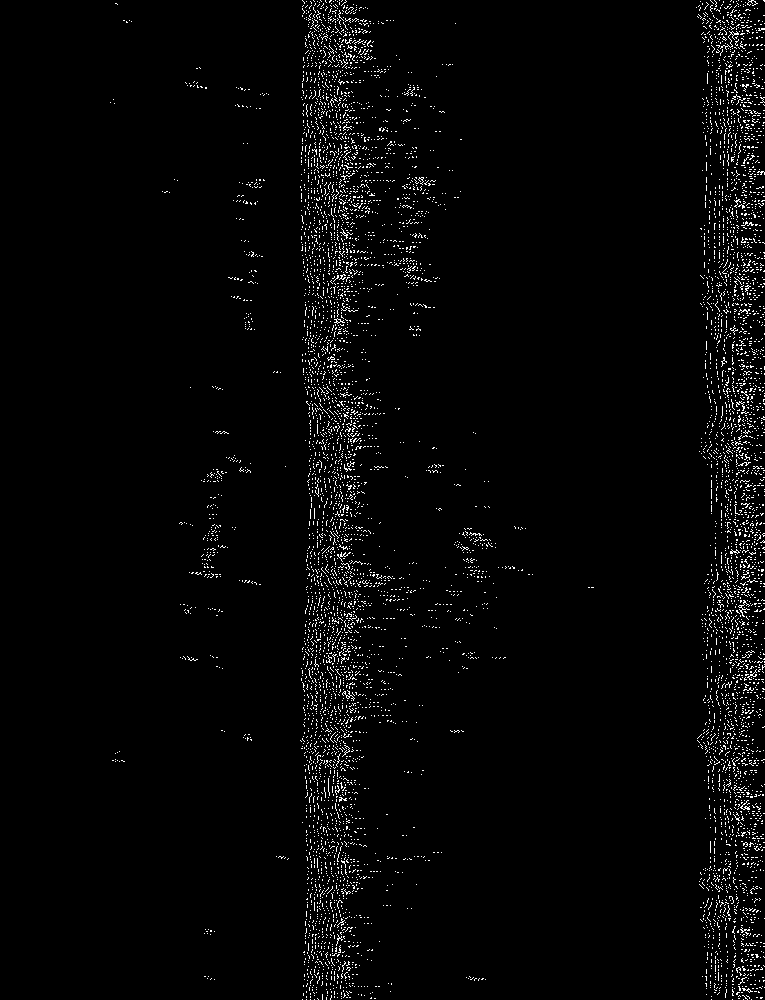

In [ ]:
cv2_imshow(img)

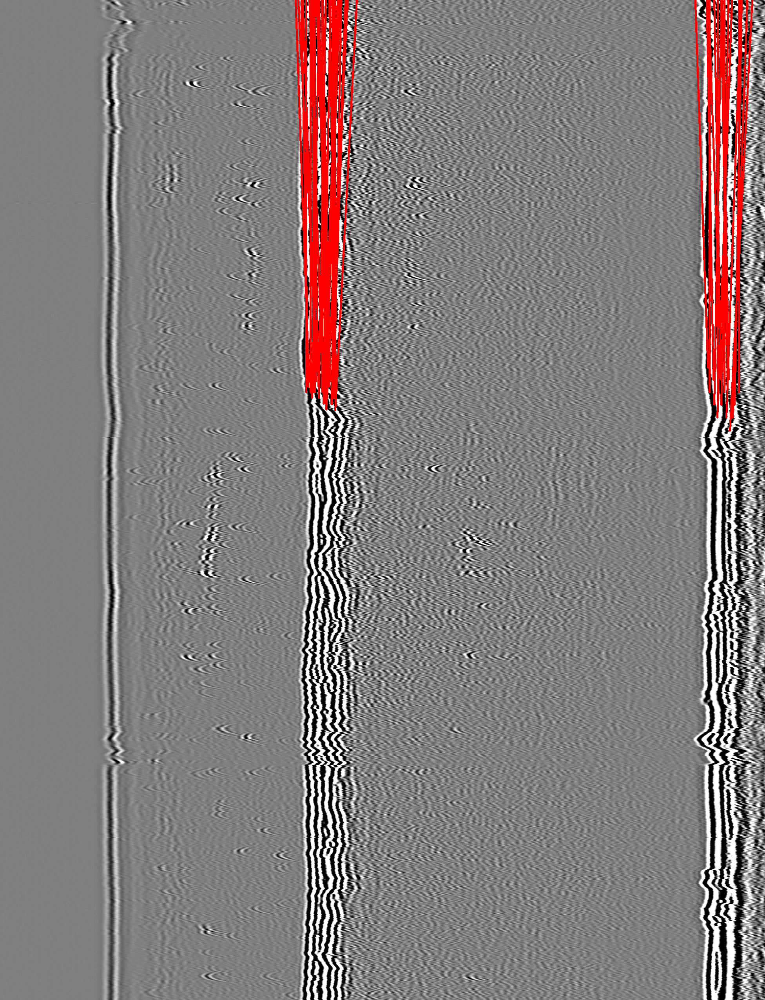

In [ ]:
thresh1 = cv2.adaptiveThreshold(im_arr, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 201, 120)
img_crop = cv2.cvtColor(im_arr,cv2.COLOR_GRAY2RGB)
line = pd.DataFrame(columns = ['x', 'grp'])
x = []
lines = cv2.HoughLines(thresh1,1,np.pi/180,800)
for i in range(lines.shape[0]):
  for rho,theta in lines[i]:
      a = np.cos(theta)
      b = np.sin(theta)
      x0 = a*rho
      y0 = b*rho

      x1 = x0 + 1000*(-b)
      y1 = y0 + 1000*(a)
      x2 = x0 - 1000*(-b)
      y2 = y0 - 1000*(a)
      cv2.line( img_crop, (int(x1), int(y1)), (int(x2), int(y2)), (0,0,255), 3)

      x.append(x0)
      cv2.circle(img,(x0, y0),3, (0,0,255), -1)

cv2_imshow(img_crop)

In [ ]:
dist = 900
line['x'] = x
line = line.sort_values('x').reset_index(drop = True)
for i in range(line.shape[0]):
  if line['x'][i] - line['x'][0] > dist:
    line['grp'][i] = 1
  else:
    line['grp'][i] = 0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
offset = 100
line1_start = line.groupby('grp').get_group(0).iloc[1]['x']
line1_end = line.groupby('grp').get_group(0).iloc[-2]['x'] + offset
line2_start = line.groupby('grp').get_group(1).iloc[1]['x']

In [ ]:
def hough(im):
  def x1_(x, y, y1, a):
    return int(round(x - a*(y - y1)**2))

  range_a = np.arange(0.2 ,5, 0.1)

  len_a = len(range_a)
  acc_arr = np.zeros(shape = (im.shape[0], im.shape[1], len_a))
  for y in range(im.shape[0]):
    for x in range(im.shape[1]):
      if im[y,x] == 255:
        for a in range(len_a):
          for y1 in range(max(0, y - 50), min(y + 50, im.shape[0])):
            x1 = x1_(x, y1, y, range_a[a])
            if x1>0 and x1<im.shape[1]:
              acc_arr[y1, x1, a] = acc_arr[y1, x1, a] + 1

  return acc_arr


In [ ]:
def draw_para(x1, y1, a, img, color):
  for y in range(y1 - 20, y1 + 20):
    x = int(x1 + a*(y - y1)**2)
    if x > x1 - 20 and x < x1 + 20:
      cv2.circle(img, (x,y), radius = 1, color = color, thickness = -1)


In [ ]:
im_arr.shape

(2549, 1952)

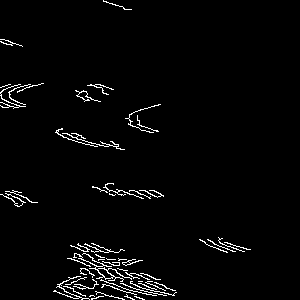

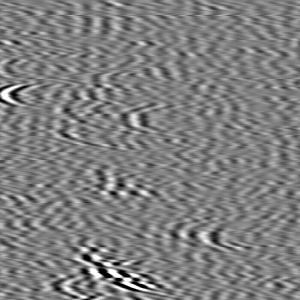

207


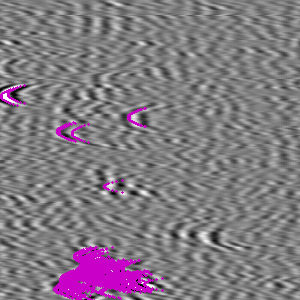

In [ ]:
im = im_arr[1100:1400, 1100:1400]
im1 = im.copy()

CannyAccThresh = cv2.threshold(im,0,255,cv2.THRESH_BINARY|cv2.THRESH_OTSU)
CannyThresh = CannyAccThresh[0]
im1 = cv2.Canny(im1,CannyThresh,4*CannyThresh)
cv2_imshow(im1)
cv2_imshow(im)
acc_arr = hough(im1)

reqd = []
for h, w, a in np.argwhere(acc_arr > 13):
  reqd.append([h, w, a])
print(len(reqd))
im_col = cv2.cvtColor(im,cv2.COLOR_GRAY2RGB)
range_a = np.arange(0.2 ,5, 0.1)
for h, w, a in reqd:
    draw_para(w,h,range_a[a], im_col, [200,0,200])

cv2_imshow(im_col)

In [ ]:
np.unique(acc_arr)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23.])

In [ ]:
im_height = 300
im_width = 250
im_offset = 50
x_coords1 = np.arange(0, line1_start - im_width, im_width - im_offset)
x_coords2 = np.arange(line1_end, line2_start - im_width, im_width - im_offset)
w_start = np.concatenate((x_coords1, [line1_start - im_width], x_coords2, [line2_start - im_width]), axis = 0)

h_start = np.arange(0,im_arr.shape[0], im_height - im_offset)

In [ ]:
np.unique(acc_arr)

array([0.])

In [ ]:
#img_crop = cv2.cvtColor(img_crop, cv2.COLOR_BGR2GRAY)
thresh = 15
reqd = []
for coord_x in w_start:
  for coord_y in h_start:
    para = im_arr[int(coord_y):int(coord_y) + int(im_height), int(coord_x):int(coord_x) + int(im_width)]
    CannyAccThresh = cv2.threshold(para,0,255,cv2.THRESH_BINARY|cv2.THRESH_OTSU)
    CannyThresh = CannyAccThresh[0]
    para = cv2.Canny(para,CannyThresh,4*CannyThresh)
    acc_arr = hough(para)
    print(coord_x, coord_y)
    for h, w, a in np.argwhere(acc_arr > thresh):
      reqd.append([h+coord_y, w +coord_x, a])

0.0 0
0.0 250
0.0 500
0.0 750
0.0 1000
0.0 1250
0.0 1500
0.0 1750
0.0 2000
0.0 2250
0.0 2500
200.0 0
200.0 250
200.0 500
200.0 750
200.0 1000
200.0 1250
200.0 1500
200.0 1750
200.0 2000
200.0 2250
200.0 2500
400.0 0
400.0 250
400.0 500
400.0 750
400.0 1000
400.0 1250
400.0 1500
400.0 1750
400.0 2000
400.0 2250
400.0 2500
441.1927490234375 0
441.1927490234375 250
441.1927490234375 500
441.1927490234375 750
441.1927490234375 1000
441.1927490234375 1250
441.1927490234375 1500
441.1927490234375 1750
441.1927490234375 2000
441.1927490234375 2250
441.1927490234375 2500
1063.6469116210938 0
1063.6469116210938 250
1063.6469116210938 500
1063.6469116210938 750
1063.6469116210938 1000
1063.6469116210938 1250
1063.6469116210938 1500
1063.6469116210938 1750
1063.6469116210938 2000
1063.6469116210938 2250
1063.6469116210938 2500
1263.6469116210938 0
1263.6469116210938 250
1263.6469116210938 500
1263.6469116210938 750
1263.6469116210938 1000
1263.6469116210938 1250
1263.6469116210938 1500
1263.64691

In [ ]:
len(reqd)

153

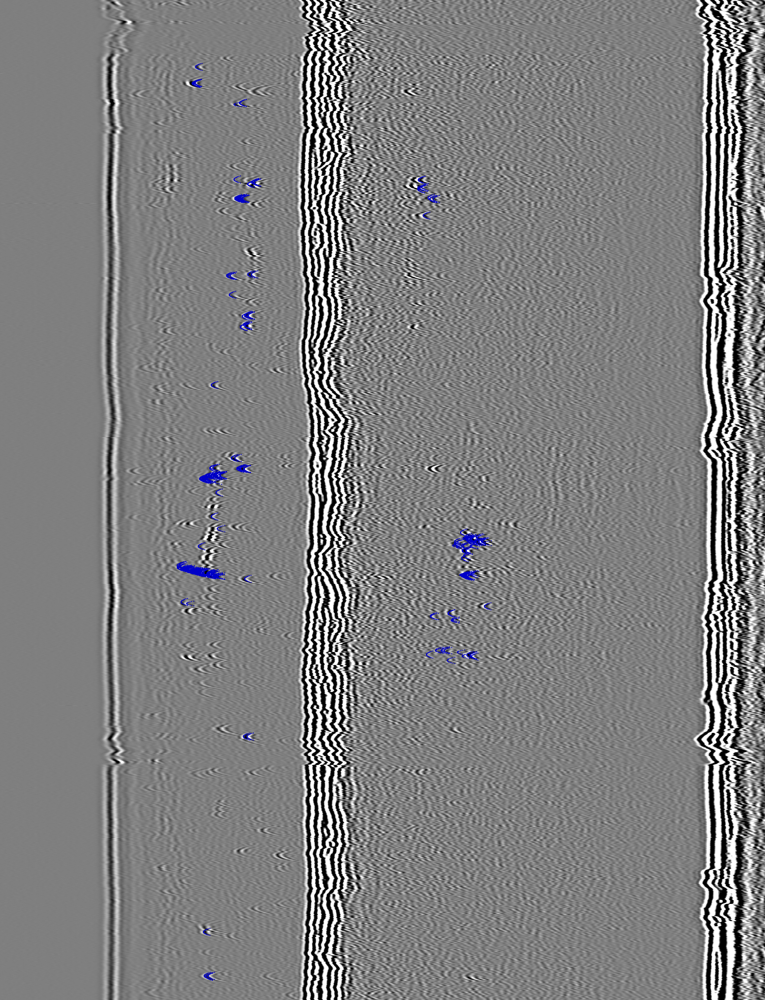

In [ ]:
#col = [[200,0,0], [100, 100, 0], [200, 100, 0], [0, 200, 0], [0, 100, 100], [0, 0, 200], [100, 0, 100], [50, 50, 200], [200, 50, 50], [50, 200, 50], [255, 0, 40]]
im_col = cv2.cvtColor(im_arr,cv2.COLOR_GRAY2RGB)
for h, w, a in reqd:
    draw_para(int(w),int(h),range_a[int(a)], im_col, [200, 0, 0])

cv2_imshow(im_col)swda

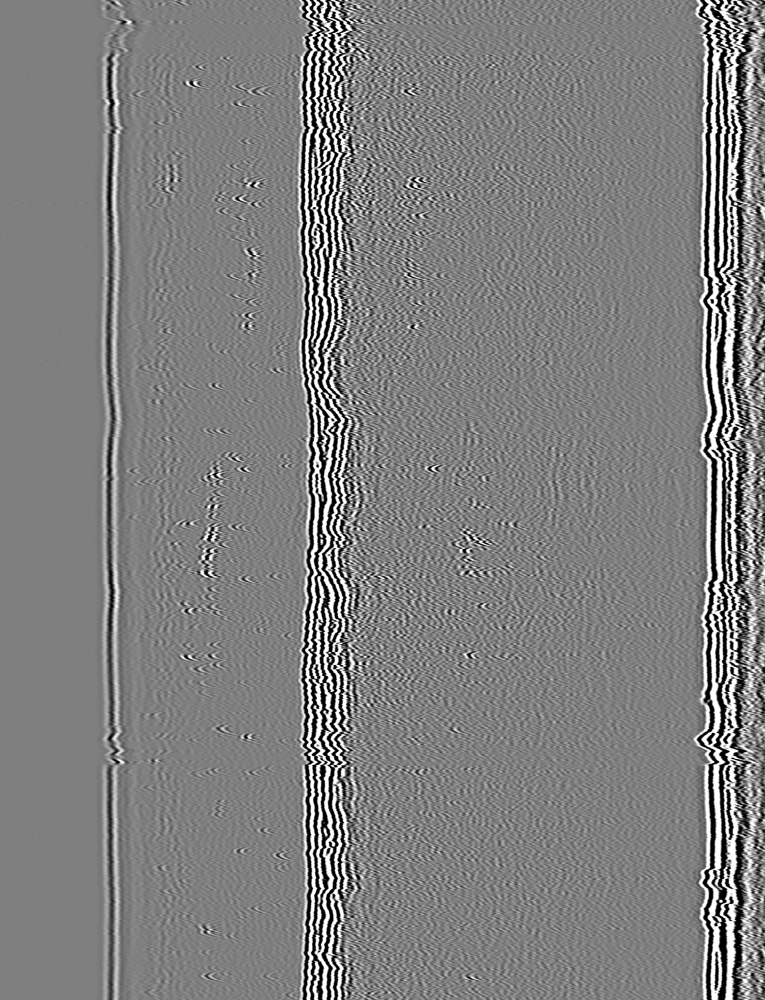

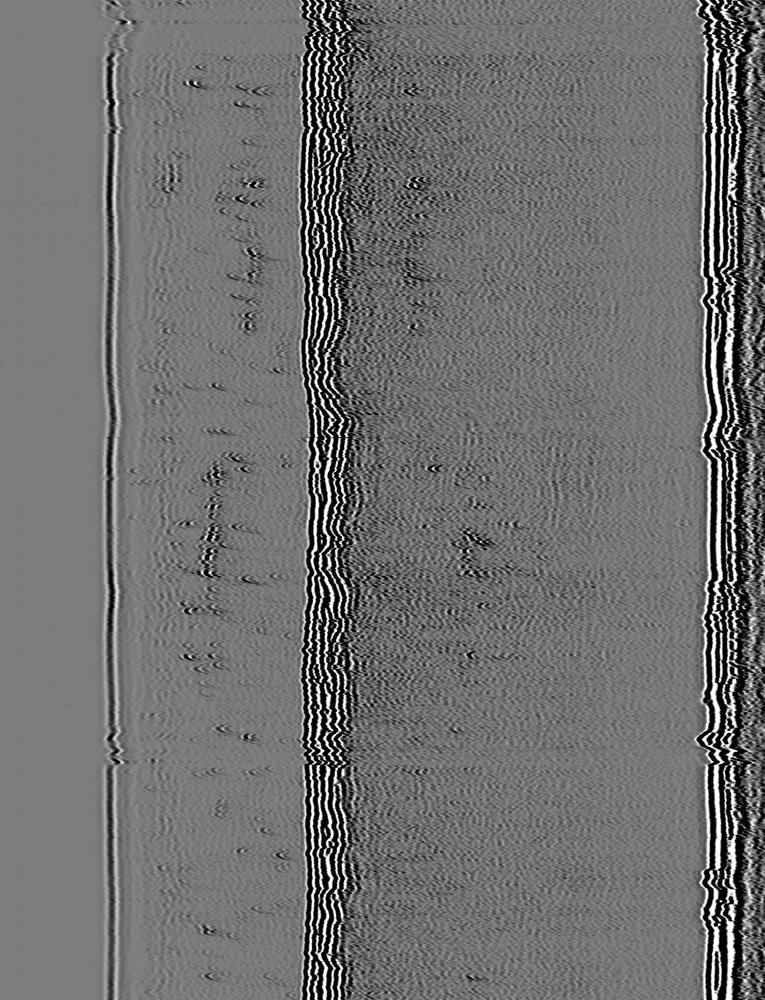

In [ ]:
cv2_imshow(im_arr)
kernel = np.ones((3, 3), np.uint8)
  
image = cv2.erode(im_arr, kernel) 
cv2_imshow(image)

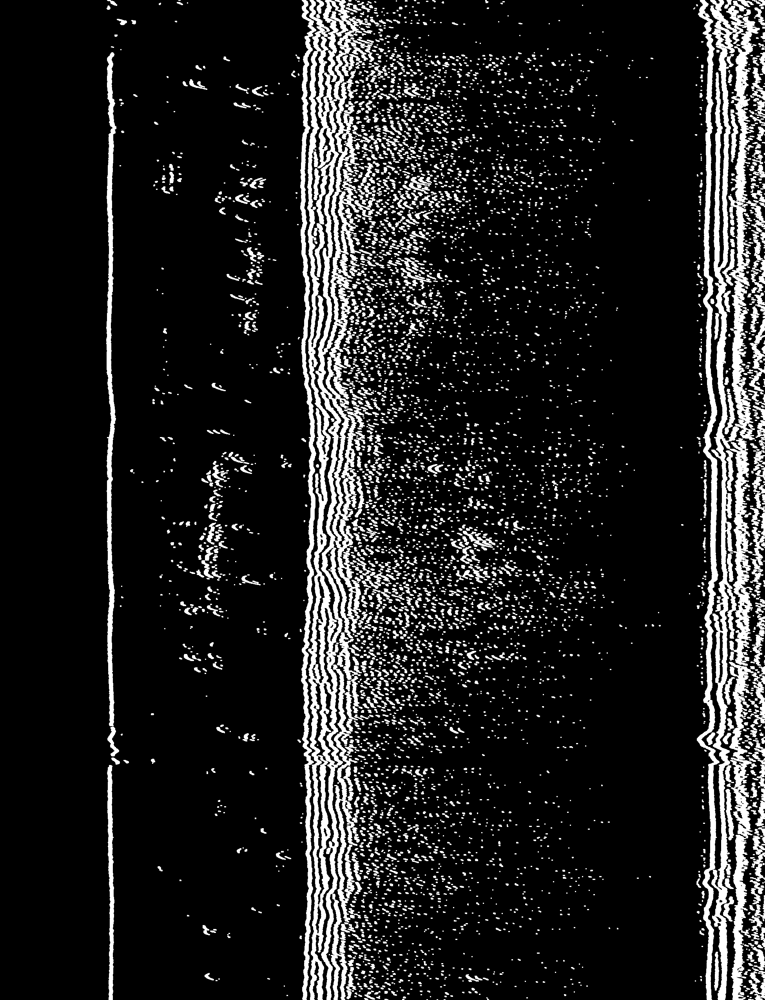

In [ ]:
im_thresh = cv2.inRange(image, 0, 80)
cv2_imshow(im_thresh)

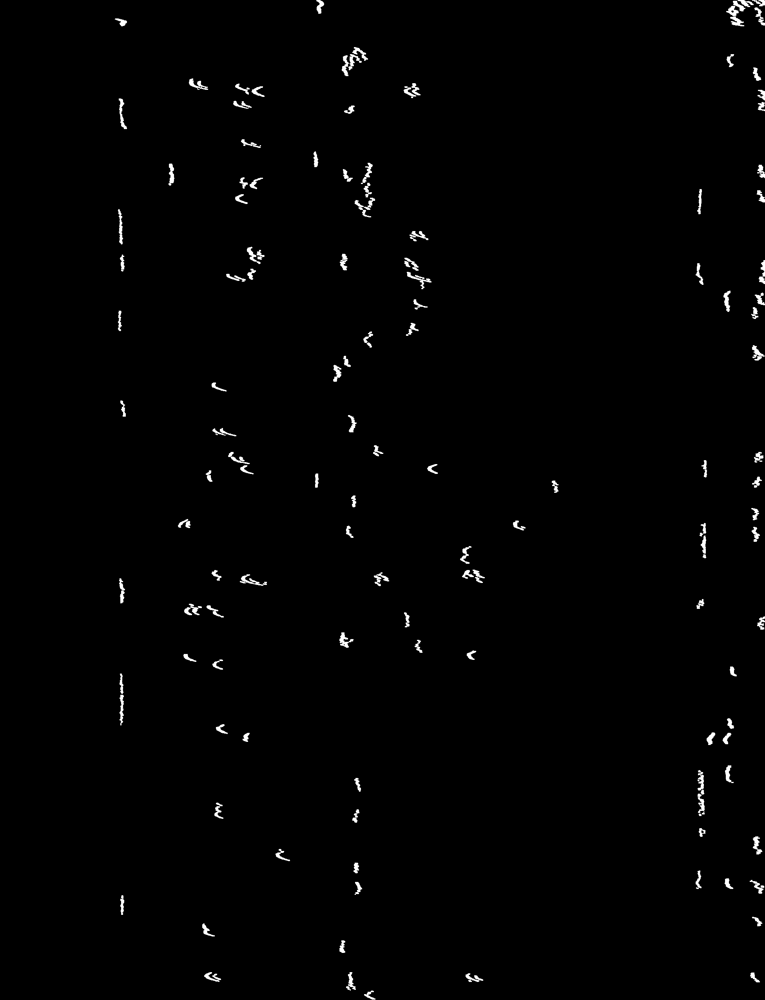

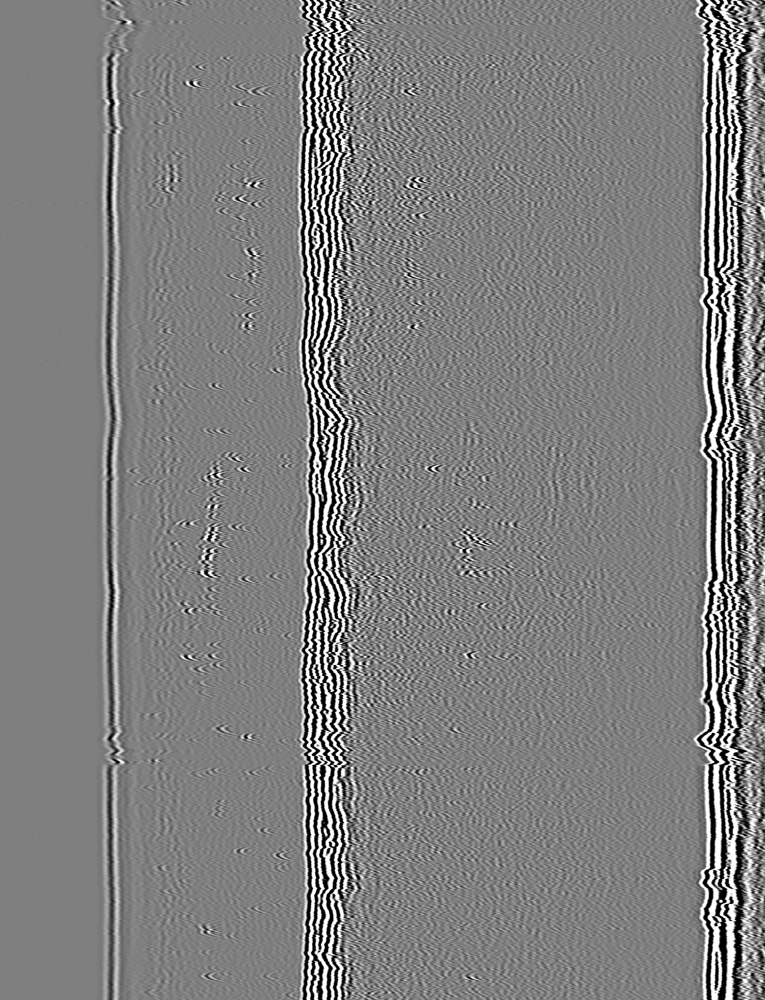

In [ ]:
contours, hierarchy = cv2.findContours(thresh1, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
mask = np.ones(thresh1.shape, dtype="uint8") * 255
for contour in contours:
  if cv2.contourArea(contour) < 200 or cv2.contourArea(contour) > 500:
    cv2.drawContours(mask, [contour], -1, 0, -1)

removed = cv2.bitwise_and(thresh1, thresh1, mask=mask)

cv2_imshow(removed)
cv2_imshow(im_arr)

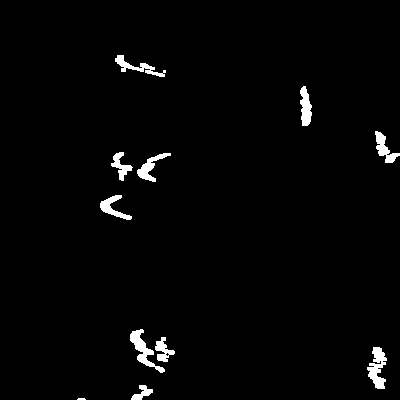

In [ ]:
im1 = removed[300:700, 500:900]
acc_arr = hough(im1)
cv2_imshow(im1)

In [ ]:
np.unique(acc_arr)

array([ 0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9., 10., 11., 12.,
       13., 14., 15., 16., 17., 18., 19., 20., 21., 22., 23.])

551


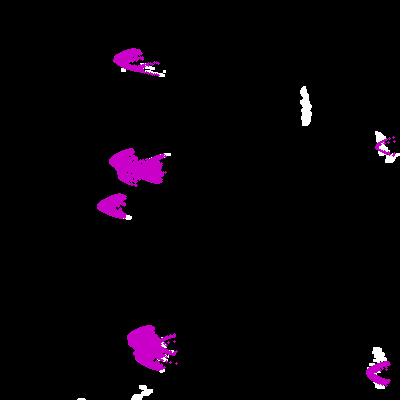

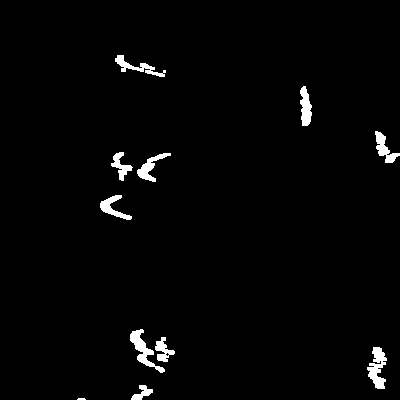

In [ ]:
reqd = []
for h, w, a in np.argwhere(acc_arr > 15):
  reqd.append([h, w, a])
print(len(reqd))
im_col = cv2.cvtColor(im1,cv2.COLOR_GRAY2RGB)
range_a = np.arange(0.2 ,5, 0.1)
for h, w, a in reqd:
    draw_para(w,h,range_a[a], im_col, [200,0,200])

cv2_imshow(im_col)
cv2_imshow(im1)

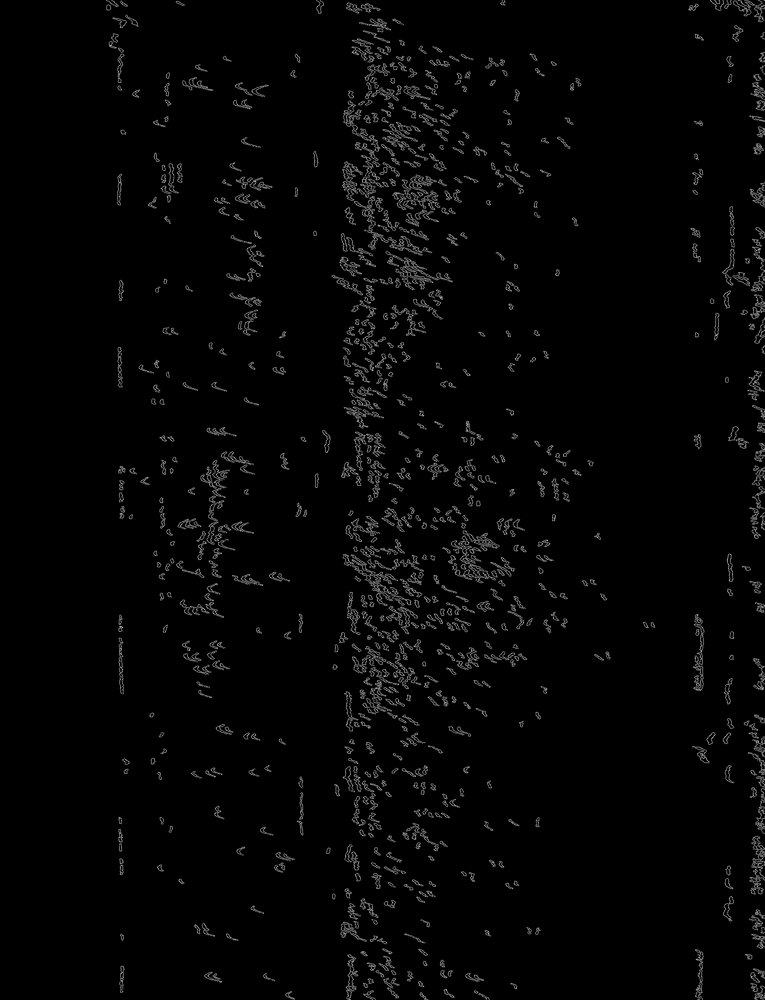

In [ ]:
canny = cv2.Canny(removed, 100, 200)
cv2_imshow(canny)

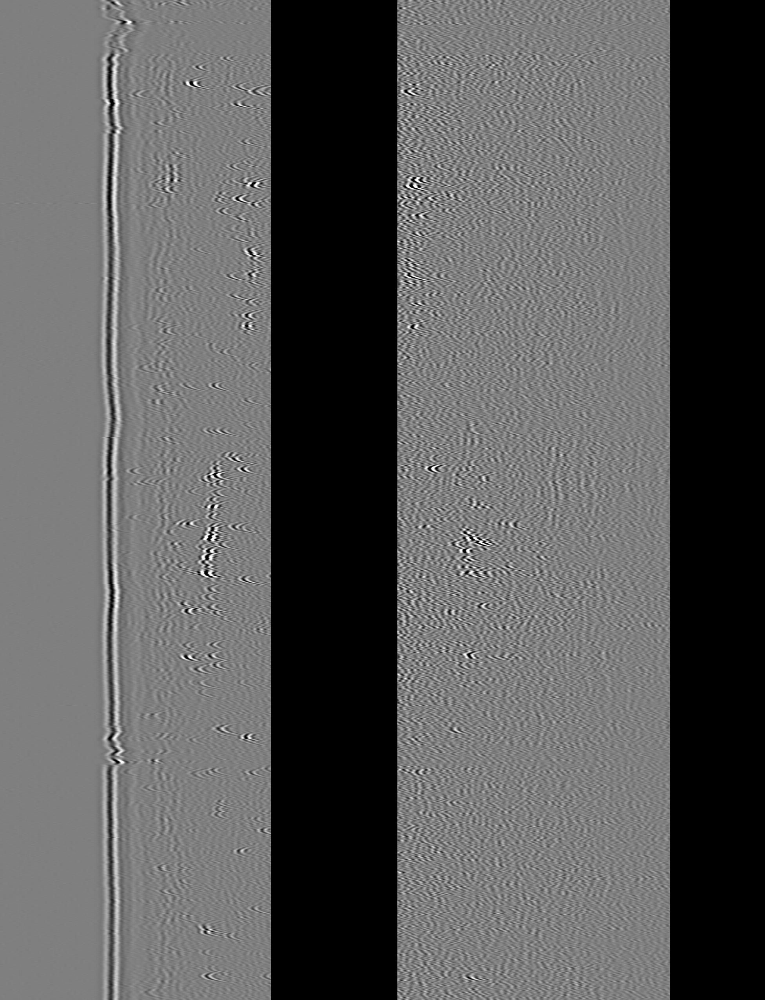

In [ ]:
im_col = cv2.cvtColor(img_crop,cv2.COLOR_GRAY2RGB)
for h, w, a in reqd:
    #cv2.circle(im, (w, h), radius = (a+1), thickness = -1, color = 200)
    draw_para(w,h,range_a[a], im_col, [200,0,0])

cv2_imshow(im_col)

In [ ]:
reqd_df = pd.DataFrame(reqd, columns = ['h', 'w', 'a'])

In [ ]:
reqd_df.max()abs(reqd_df['h'][i + 1] - reqd_df['h'][i]) > 5

In [ ]:
reqd_df = pd.DataFrame(reqd, columns = ['h', 'w', 'a'])
reqd_df = reqd_df.sort_values(['h', 'w'])
reqd_df[reqd_df]

In [ ]:
reqd_df = pd.DataFrame(reqd, columns = ['h', 'w', 'a'])
reqd_df = reqd_df.sort_values(['h'])
reqd_df = reqd_df.reset_index(drop = True)
reqd_df['grp_h'] = np.nan
grp = 0
for i in range(len(reqd_df) - 1):
  reqd_df['grp_h'][i] = grp
  if abs(reqd_df['h'][i + 1] - reqd_df['h'][i]) > 5:
    grp = grp + 1

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [ ]:
#reqd_df = pd.DataFrame(reqd, columns = ['h', 'w', 'a'])
reqd_df = reqd_df.sort_values(['grp_h', 'w'])
reqd_df[reqd_df['h'] < 30]

,h,w,a,grp_h
0,9,1872,1,0.0
11,20,884,7,1.0
2,18,900,4,1.0
4,18,900,5,1.0
1,17,908,3,1.0
10,19,910,15,1.0
3,18,1824,0,1.0
9,19,1824,1,1.0
8,19,1824,3,1.0
7,19,1824,4,1.0


In [ ]:
sel_grps = []
for i in range(int(reqd_df['grp'].max() + 1)):
  if len(reqd_df.groupby('grp').get_group(i)) > 1 and len(reqd_df.groupby('grp').get_group(i)) < 10:
    sel_grps.append(i)
    

In [ ]:
grp = 0
for i in range(len(reqd_df) - 1):
  reqd_df['grp'][i] = grp
  if abs(reqd_df['h'][i + 1] - reqd_df['h'][i]) > 5:
    grp = grp + 1
  

In [ ]:
reqd_df

,h,w,a,grp
0,6,100,0,0
1,6,100,1,0
2,6,109,0,0
3,6,110,0,0
4,6,120,0,0
...,...,...,...,...
84,252,88,1,10
85,252,95,2,10
86,252,96,2,10
87,252,107,2,10


In [ ]:
sel_para = []
for grp in sel_grps:
  para1 = reqd_df.groupby('grp').get_group(grp).sort_values('w').reset_index(drop = True).iloc[0]
  para2 = reqd_df.groupby('grp').get_group(grp).sort_values('w').reset_index(drop = True).iloc[-1]
  sel_para.append(para1)
  sel_para.append(para2)


In [ ]:
im_col = cv2.cvtColor(im_arr,cv2.COLOR_GRAY2RGB)
for h,w,a,grp in sel_para:
  draw_para(int(w),int(h),range_a[int(a)], im_col, col[int(grp)%len(col)])

cv2_imshow(im_col)

In [ ]:
sel_para_df = pd.DataFrame(sel_para)
sel_para_df.sort_values('h')

,h,w,a,grp
1,17.0,908.0,3.0,1.0
0,18.0,900.0,4.0,1.0
0,19.0,1824.0,4.0,4.0
4,19.0,1825.0,0.0,4.0
1,19.0,910.0,15.0,5.0
...,...,...,...,...
6,2487.0,531.0,0.0,910.0
0,2487.0,1187.0,0.0,911.0
4,2489.0,1210.0,1.0,911.0
0,2535.0,728.0,4.0,915.0


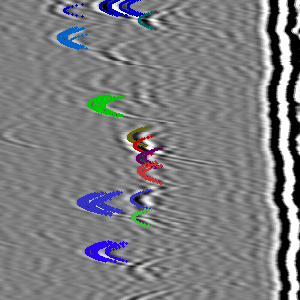

In [ ]:
col = [[200,0,0], [100, 100, 0], [200, 100, 0], [0, 200, 0], [0, 100, 100], [0, 0, 200], [100, 0, 100], [50, 50, 200], [200, 50, 50], [50, 200, 50], [255, 0, 40]]
im_col = cv2.cvtColor(para,cv2.COLOR_GRAY2RGB)
for h, w, a, grp in np.array(reqd_df):
    draw_para(w,h,range_a[a], im_col, col[int(grp)])

cv2_imshow(im_col)

In [ ]:
reqd[0]

array([  6, 100,   0])

In [ ]:
cv2.imwrite('/drive/MyDrive/train_set/binary2.png', im1)

True